# Topic modeling for the chat

### !!! WARNING !!!

In chat examples you might see some swear words and sensitive topics, so if you are not comfortable with that, please skip this notebook.

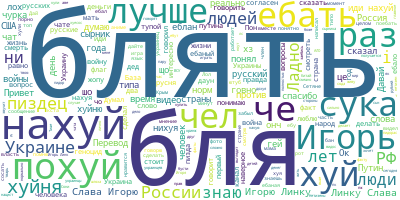

## What is topic modeling?

Topic modeling - is a method of finding topics in the text. It is used to find the most frequent topics in the text.

## What is BERTopic?

BERTopic - is a topic modeling library that uses BERT embeddings to find topics in the text. Look at the [documentation](https://maartengr.github.io/BERTopic/) for more information.

## What is sentence-transformers?

Sentence-transformers - is a library that allows us to convert sentences to vectors. Look at the [documentation](https://www.sbert.net/) for more information.

## Why do we need topic modeling?

We need topic modeling to find the most frequent topics in the chat. It will help us to understand what is the chat about and what are the most frequent topics in the chat.

## What is the goal of this notebook?

The goal of this notebook is to find the most frequent topics in the chat and visualize them.
It will help us to understand what is the chat about and what are the most frequent topics in the chat.

## What is the plan?

1. We need to install the dependencies
2. We need to load the data from the json file
3. We need to lemmatize the text
4. Filter out the empty messages by lemmatized text
5. Create wordcloud to visualize the most frequent words
6. Create sentence embeddings
7. Create topic model
8. Reduce the number of topics
9. Assign topics to the messages

## Внимание!

В примерах из чата вы можете увидеть некоторые ругательства и чувствительные темы, поэтому, если вам это не нравится, пожалуйста, пропустите этот ноутбук.

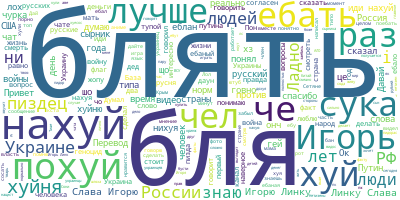

## Что такое топик моделинг?

Топик моделинг - это метод нахождения тем в тексте. Он используется для нахождения самых частых тем в тексте.

## Что такое BERTopic?

BERTopic - это библиотека для топик моделинга, которая использует BERT эмбеддинги для нахождения тем в тексте. Посмотрите [документацию](https://maartengr.github.io/BERTopic/) для получения дополнительной информации.

## Что такое sentence-transformers?

Sentence-transformers - это библиотека, которая позволяет нам преобразовывать предложения в векторы. Посмотрите [документацию](https://www.sbert.net/) для получения дополнительной информации.

## Зачем нам нужен топик моделинг?

Нам нужен топик моделинг, чтобы найти самые частые темы в чате. Это поможет нам понять, о чем чат и какие самые частые темы в чате.

## Какова цель этого ноутбука?

Цель этого ноутбука - найти самые частые темы в чате и визуализировать их.
Это поможет нам понять, о чем чат и какие самые частые темы в чате.

## Какой план?

1. Нам нужно установить зависимости
2. Нам нужно загрузить данные из json файла
3. Нам нужно лемматизировать текст
4. Отфильтровать пустые сообщения по лемматизированному тексту
5. Создать облако слов для визуализации самых частых слов
6. Создать эмбеддинги предложений
7. Создать модель топиков
8. Уменьшить количество топиков
9. Присвоить топики сообщениям


## Installing the dependencies

We need to install the dependencies for the project:
- tqdm - progress bar
- pandas - dataframes (excel-like tables for python)
- spacy - lemmatization (converting words to their base form)
- wordcloud - wordclouds (visualizing the most frequent words)
- sentence-transformers - sentence embeddings (converting sentences to vectors)
- bertopic - topic modeling (finding topics in the text using embeddings)
- ru_core_news_sm - russian language model for spacy

## Установка зависимостей

Нам нужно установить зависимости для проекта:
- tqdm - прогресс бар
- pandas - датафреймы (таблицы в стиле excel для python)
- spacy - лемматизация (преобразование слов в их базовую форму)
- wordcloud - облака слов (визуализация самых частых слов)
- sentence-transformers - эмбеддинги предложений (преобразование предложений в векторы)
- bertopic - топик моделинг (нахождение тем в тексте с помощью эмбеддингов)
- ru_core_news_sm - русская языковая модель для spacy

In [1]:
# %conda install -q -y -c conda-forge spacy cupy tqdm pandas wordcloud sentence-transformers bertopic

In [2]:
%%bash
python -m spacy download ru_core_news_sm

Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.3/15.3 MB 53.9 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('ru_core_news_sm')


## Configuring the environment

To see the progress bar we need to configure the environment to use the notebook
It allows us to use progress_apply instead of apply when working with dataframes

## Настройка окружения

Чтобы увидеть прогресс бар, нам нужно настроить окружение для использования ноутбука
Это позволяет нам использовать progress_apply вместо apply при работе с датафреймами

In [3]:
import json
import os

import pandas as pd
import spacy
from bertopic import BERTopic
from bertopic.representation import KeyBERTInspired, PartOfSpeech, MaximalMarginalRelevance
from bertopic.vectorizers import ClassTfidfTransformer
from sentence_transformers import SentenceTransformer
from sklearn.feature_extraction.text import CountVectorizer
from tqdm.auto import tqdm
# one of those issues here: https://github.com/lmcinnes/umap/issues/775
from cuml.cluster import HDBSCAN
from cuml.manifold import UMAP

/home/andrei/miniconda3/envs/rapids-23.06/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/andrei/miniconda3/envs/rapids-23.06/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/andrei/miniconda3/envs/rapids-23.06/lib/python3.10


===================================BUG REPORT===================================
Welcome to bitsandbytes. For bug reports, please run

python -m bitsandbytes

 and submit this information together with your error trace to: https://github.com/TimDettmers/bitsandbytes/issues
bin /home/andrei/miniconda3/envs/rapids-23.06/lib/python3.10/site-packages/bitsandbytes/libbitsandbytes_cuda118.so
CUDA SETUP: CUDA runtime path found: /home/andrei/miniconda3/envs/rapids-23.06/lib/libcudart.so.11.0
CUDA SETUP: Highest compute capability among GPUs detected: 8.6
CUDA SETUP: Detected CUDA version 118
CUDA SETUP: Loading binary /home/andrei/miniconda3/envs/rapids-23.06/lib/python3.10/site-packages/bitsandbytes/libbitsandbytes_cuda118.so...


In [4]:
tqdm.pandas()

In [5]:
os.environ["TOKENIZERS_PARALLELISM"] = "true"

In [6]:
os.makedirs('./output', exist_ok=True)
os.makedirs('./output/visualizations', exist_ok=True)
os.makedirs('./output/models', exist_ok=True)

## Setting parallelism for tokenizers

We need to set parallelism for tokenizers to speed up the process

## Установка параллелизма для токенизаторов

Нам нужно установить параллелизм для токенизаторов, чтобы ускорить процесс

## We need to load the data from the json file

We got the chat export kindly provided by [Igor](https://t.me/IgorLinkChannel) and we need to load it into the dataframe
Thanks Igor!

## Нам нужно загрузить данные из json файла

Мы получили экспорт чата, любезно предоставленный нам [Игорем](https://t.me/IgorLinkChannel), и нам нужно загрузить его в датафрейм
Спасибо Игорь!

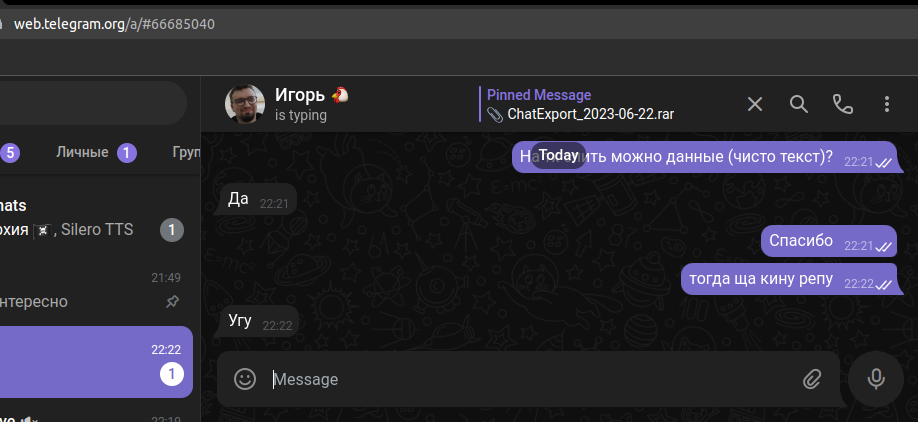

In [7]:
with open('./chat_export.json', 'r', encoding='utf8') as f:
    json_data = json.load(f)

df = pd.DataFrame(json_data['messages'])
df = df[df['text'].apply(lambda x: isinstance(x, str) and len(x.strip()) > 1)].sample(100000)

df

,id,type,date,date_unixtime,from,from_id,text,text_entities,edited,edited_unixtime,...,location_information,game_title,game_description,game_link,author,members,inviter,contact_information,duration,live_location_period_seconds
615232,7044757,message,2023-06-09T21:53:57,1686340437,Олег (Точно не Александр),user1211129287,Все кто меня не любит\n\nЯ желаю вам только до...,"[{'type': 'plain', 'text': 'Все кто меня не лю...",NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
605219,7034389,message,2023-06-06T16:24:21,1686061461,Denis,user5217940620,"Если это ни к чему не привело в 2021, значит в...","[{'type': 'plain', 'text': 'Если это ни к чему...",2023-06-06T16:24:58,1686061498,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34049,6221931,message,2022-12-04T15:33:53,1670164433,что-то и кто-то,user5598298194,)),"[{'type': 'plain', 'text': '))'}]",NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
319885,6688273,message,2023-03-01T18:38:43,1677692323,Демьян🪳,user1446790202,"Также сегодня была взята Луганщина, где украна...","[{'type': 'plain', 'text': 'Также сегодня была...",NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50743,6247551,message,2022-12-07T14:26:34,1670419594,「 σχуg🍜🇺🇦 」,user1834355745,все игры на телефон это блять максимум динозав...,"[{'type': 'plain', 'text': 'все игры на телефо...",NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
377903,6769843,message,2023-03-26T23:18:26,1679865506,ミ♡🎯.°୭̥ 𝗹𝗲𝗰𝗵𝗮𝗶𝗶 |¡ ;,user629094764,я вас ободаю юлже,"[{'type': 'plain', 'text': 'я вас ободаю юлже'}]",2023-03-26T23:18:32,1679865512,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
246107,6574201,message,2023-02-05T20:12:14,1675624334,None,user1921045881,Ну как там Вашингтон за 3 дня?),"[{'type': 'plain', 'text': 'Ну как там Вашингт...",NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
200563,6501711,message,2023-01-16T07:23:54,1673850234,Артём,user1694084361,Потому что у нас за протесты дают больше срок ...,"[{'type': 'plain', 'text': 'Потому что у нас з...",NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
78090,6294290,message,2022-12-12T15:12:34,1670854354,CRVLDXVC,user5529270608,МОЛОТОЧКОМ ПО ПИЗДЕ АХХ,"[{'type': 'plain', 'text': 'МОЛОТОЧКОМ ПО ПИЗД...",2022-12-12T15:12:42,1670854362,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Creating topic model

We need to create topic model to find the most frequent topics in the chat.

## Создание топик модели

Нам нужно создать топик модель, чтобы найти самые частые темы в чате.

In [8]:
# from langchain.experimental.llms import RELLM
# from langchain.llms import HuggingFacePipeline
# from langchain.chains.question_answering import load_qa_chain
# from transformers import pipeline
# from bertopic.representation import LangChain
# import regex  # Note this is the regex library NOT python's re stdlib module
#
# hf_model = pipeline(
#     "text-generation", model="cerebras/Cerebras-GPT-590M", max_new_tokens=200
# )
#
# pattern = regex.compile(
#     r'\topic:\s*(\{.*\}|"[^"]*")'
# )
# model = RELLM(pipeline=hf_model, regex=pattern, max_new_tokens=200)
# chain = load_qa_chain(llm=model, chain_type="stuff")
# langchain_representation = LangChain(chain)

In [9]:
keybert_representation = KeyBERTInspired()

In [10]:
part_of_speech_representation = PartOfSpeech('ru_core_news_sm')

In [11]:
aspect_model2 = [KeyBERTInspired(top_n_words=30), MaximalMarginalRelevance(diversity=.5)]

In [12]:
representation_model = {
    "Main": keybert_representation,
    "Aspect1": part_of_speech_representation,
    "Aspect2": aspect_model2
}

In [13]:
nlp = spacy.load('ru_core_news_sm')
stop_words = list(nlp.Defaults.stop_words)
# set_global_device_type('CPU')

# Create instances of GPU-accelerated UMAP and HDBSCAN
umap_model = UMAP(
    metric='cosine',
    n_components=5,
    min_dist=0.0,
)
hdbscan_model = HDBSCAN(
    min_cluster_size=30,
    prediction_data=True,
)
count_vectorizer = CountVectorizer(stop_words=stop_words, min_df=0.02, max_df=0.98, ngram_range=(1, 2))
ctdidf_vectorizer = ClassTfidfTransformer(reduce_frequent_words=True, bm25_weighting=True)
sentence_model = SentenceTransformer('inkoziev/sbert_pq', device='cuda')

In [14]:
documents = list(df['text'])

In [15]:
# Pass the above models to be used in BERTopic
topic_model = BERTopic(
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=count_vectorizer,
    ctfidf_model=ctdidf_vectorizer,
    embedding_model=sentence_model,
    representation_model=representation_model,
    calculate_probabilities=True,
    verbose=True,
    nr_topics="auto"
)

topics, probabilities = topic_model.fit_transform(documents=documents)
topic_model.save("./output/models/telegram_comments", serialization="safetensors")

Batches:   0%|          | 0/3125 [00:00<?, ?it/s]

2023-07-14 23:53:54,505 - BERTopic - Transformed documents to Embeddings
2023-07-14 23:53:57,834 - BERTopic - Reduced dimensionality
2023-07-14 23:54:00,815 - BERTopic - Clustered reduced embeddings
2023-07-14 23:54:22,969 - BERTopic - Reduced number of topics from 245 to 198


In [16]:
visualized_original = topic_model.visualize_documents(docs=documents, hide_annotations=True)
with open('./output/visualizations/telegram_comments_original.html', 'w', encoding='utf8') as f:
    f.write(visualized_original.to_html())
visualized_original

In [17]:
topic_model.visualize_hierarchy(top_n_topics=50)

## Reduced topics

We can see the reduced topics after reducing them.

## Сокращенные топики

Мы можем увидеть сокращенные топики после их сокращения.

In [18]:
topic_model.reduce_topics(docs=documents, nr_topics="auto")
topic_model.save("./output/models/telegram_comments_reduced_topics", serialization="safetensors")

2023-07-14 23:56:32,138 - BERTopic - Reduced number of topics from 198 to 20


In [19]:
visualized_reduced_topics = topic_model.visualize_documents(docs=documents, hide_annotations=True)
with open('./output/visualizations/telegram_comments_reduced_topics.html', 'w', encoding='utf8') as f:
    f.write(visualized_reduced_topics.to_html())
visualized_reduced_topics

## Assigning topics to the messages

We need to assign topics to the messages to find the most frequent topics in the chat.

## Присвоение топиков сообщениям

Нам нужно присвоить топики сообщениям, чтобы найти самые частые темы в чате.

In [20]:
df = topic_model.get_document_info(df['text'], df)
df.to_csv('./output/messages_with_topics.csv', encoding='utf-8-sig')
df

,id,type,date,date_unixtime,from,from_id,text,text_entities,edited,edited_unixtime,...,Document,Topic,Name,Representation,Aspect1,Aspect2,Representative_Docs,Top_n_words,Probability,Representative_document
0,7044757,message,2023-06-09T21:53:57,1686340437,Олег (Точно не Александр),user1211129287,Все кто меня не любит\n\nЯ желаю вам только до...,"[{'type': 'plain', 'text': 'Все кто меня не лю...",NaN,NaN,...,Все кто меня не любит\n\nЯ желаю вам только до...,0,0_слова_це_але_шо,"[слова, це, але, шо, ок, мене, два, пон, вони,...","[пон, слова, мене, раз, чел, слово, від, людей...","[це, ок, два, як, 20, мені, ало, чел, лох, 10]",[С если грубо говоря форд перестанет платить...,слова - це - але - шо - ок - мене - два - пон ...,0.969395,False
1,7034389,message,2023-06-06T16:24:21,1686061461,Denis,user5217940620,"Если это ни к чему не привело в 2021, значит в...","[{'type': 'plain', 'text': 'Если это ни к чему...",2023-06-06T16:24:58,1686061498,...,"Если это ни к чему не привело в 2021, значит в...",-1,-1_че_хуйню_слава_иди,"[че, хуйню, слава, иди, слова, спасибо, правда...","[человек, говно, день, хуйню, пиздец, спасибо,...","[слава, слова, спасибо, член, сша, войны, игор...",[я люблю дохинга.. он такой..такой.. я не прос...,че - хуйню - слава - иди - слова - спасибо - п...,0.681268,False
2,6221931,message,2022-12-04T15:33:53,1670164433,что-то и кто-то,user5598298194,)),"[{'type': 'plain', 'text': '))'}]",NaN,NaN,...,)),-1,-1_че_хуйню_слава_иди,"[че, хуйню, слава, иди, слова, спасибо, правда...","[человек, говно, день, хуйню, пиздец, спасибо,...","[слава, слова, спасибо, член, сша, войны, игор...",[я люблю дохинга.. он такой..такой.. я не прос...,че - хуйню - слава - иди - слова - спасибо - п...,0.915322,False
3,6688273,message,2023-03-01T18:38:43,1677692323,Демьян🪳,user1446790202,"Также сегодня была взята Луганщина, где украна...","[{'type': 'plain', 'text': 'Также сегодня была...",NaN,NaN,...,"Также сегодня была взята Луганщина, где украна...",-1,-1_че_хуйню_слава_иди,"[че, хуйню, слава, иди, слова, спасибо, правда...","[человек, говно, день, хуйню, пиздец, спасибо,...","[слава, слова, спасибо, член, сша, войны, игор...",[я люблю дохинга.. он такой..такой.. я не прос...,че - хуйню - слава - иди - слова - спасибо - п...,0.066259,False
4,6247551,message,2022-12-07T14:26:34,1670419594,「 σχуg🍜🇺🇦 」,user1834355745,все игры на телефон это блять максимум динозав...,"[{'type': 'plain', 'text': 'все игры на телефо...",NaN,NaN,...,все игры на телефон это блять максимум динозав...,3,3_игру_игр_игры_плей,"[игру, игр, игры, плей, игре, ноут, кину, игор...","[игра, игры, рублей, грн, игре, плей, игру, те...","[игру, кину, брал, комп, играл, куплю, напишет...",[«Устал от донатных второсортных шутеров? Беся...,игру - игр - игры - плей - игре - ноут - кину ...,0.261146,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,6769843,message,2023-03-26T23:18:26,1679865506,ミ♡🎯.°୭̥ 𝗹𝗲𝗰𝗵𝗮𝗶𝗶 |¡ ;,user629094764,я вас ободаю юлже,"[{'type': 'plain', 'text': 'я вас ободаю юлже'}]",2023-03-26T23:18:32,1679865512,...,я вас ободаю юлже,4,4_живой_слава украине_живу_слава нации,"[живой, слава украине, живу, слава нации, жиза...","[украинец, фамилия, жизни, живой, жизнь, еврей...","[слава украине, живу, жиза слава, фамилия, жиз...","[Каком конфликте? Ты блять жилец барака, единс...",живой - слава украине - живу - слава нации - ж...,0.307831,False
99996,6574201,message,2023-02-05T20:12:14,1675624334,None,user1921045881,Ну как там Вашингтон за 3 дня?),"[{'type': 'plain', 'text': 'Ну как там Вашингт...",NaN,NaN,...,Ну как там Вашингтон за 3 дня?),1,1_путинистам слава_войну_власти_германии,"[путинистам слава, войну, власти, германии, ст...","[украинцы, войну, русские, армия, демократия, ...","[войну, власти, германии, геноцид, украину, им...",[ИДИ СЮДА ПИДОР ЕБАНЫЙ СЕЙЧАС ЕБАЛО ТЕБЕ БУДЕМ...,путинистам слава - войну - власти - германии -...,0.315617,False
99997,6501711,message,2023-01-16T07:23:54,1673850234,Артём,user1694084

## Conclusion

We have created topic model and found the most frequent topics in the chat.
As we can see, the most frequent topics are:
- "Swearing" - users are swearing in the chat (it is the most frequent topic)
- "Politics" - users are discussing politics (especially insulting based on nationality)
- "Insults" - users are insulting each other  (especially based on nationality)

## Вывод

Мы создали топик модель и нашли самые частые темы в чате.
Как мы видим, самые частые темы:
- "Swearing" - пользователи ругаются в чате (это самая частая тема)
- "Politics" - пользователи обсуждают политику (особенно оскорбления на основе национальности)
- "Insults" - пользователи оскорбляют друг друга (особенно на основе национальности)

## Post-Scriptum

Igor, I'm sorry for your eyes and brain. I can't imagine how you can read this chat every day.

## Постскриптум

Игорь, мне жаль твои глаза и мозг. Я не представляю, как ты можешь читать этот чат каждый день.